# 基本設定

In [1]:
import torch, cv2, numpy, yaml, einops
print("環境 OK")


環境 OK


In [ ]:
# 下載 MobileIE 原始碼
# !git clone https://github.com/AVC2-UESTC/MobileIE.git
# %cd MobileIE


Cloning into 'MobileIE'...
remote: Enumerating objects: 252, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 252 (delta 1), reused 0 (delta 0), pack-reused 244 (from 1)
Receiving objects: 100% (252/252), 7.80 MiB | 12.45 MiB/s, done.
Resolving deltas: 100% (96/96), done.
/content/MobileIE


In [ ]:
# 安裝依賴（requirements）
# !pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
# !pip install opencv-python opencv-contrib-python
# !pip install pyyaml tqdm einops pillow numpy



Looking in indexes: https://download.pytorch.org/whl/cu118


建立 experiments 資料夾

In [ ]:
# mkdir -p /content/MobileIE/experiments


建立 dataset 資料夾

In [ ]:
# mkdir -p /content/MobileIE/dataset/LOL


從雲端解壓縮 LOL-v2

In [ ]:
# !unzip -qq "/content/drive/MyDrive/MobileIE/LOL-v2.zip" -d "/content/LOLv2"


unzip:  cannot find or open /content/drive/MyDrive/MobileIE/LOL-v2.zip, /content/drive/MyDrive/MobileIE/LOL-v2.zip.zip or /content/drive/MyDrive/MobileIE/LOL-v2.zip.ZIP.


# 下載 ExDark(明暗對比強烈的資料集)

In [7]:
!pip install gdown

In [8]:
!gdown --id 1BHmPgu8EsHoFDDkMGLVoXIlCth2dW6Yx -O /content/ExDark.zip


/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1BHmPgu8EsHoFDDkMGLVoXIlCth2dW6Yx
From (redirected): https://drive.google.com/uc?id=1BHmPgu8EsHoFDDkMGLVoXIlCth2dW6Yx&confirm=t&uuid=993ef1b4-7569-4df9-805b-e3e51a89741c
To: /content/ExDark.zip
100% 1.49G/1.49G [00:20<00:00, 72.2MB/s]


In [9]:
!unzip /content/ExDark.zip -d /content/contrast_dataset


串流輸出內容已截斷至最後 5000 行。
  inflating: /content/contrast_dataset/ExDark/Motorbike/2017_07361.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2017_07361.jpg  
  inflating: /content/contrast_dataset/ExDark/Motorbike/2015_06160.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2015_06160.jpg  
  inflating: /content/contrast_dataset/ExDark/Motorbike/2015_05864.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2015_05864.jpg  
  inflating: /content/contrast_dataset/ExDark/Motorbike/2015_05870.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2015_05870.jpg  
  inflating: /content/contrast_dataset/ExDark/Motorbike/2015_05858.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2015_05858.jpg  
  inflating: /content/contrast_dataset/ExDark/Motorbike/2015_05874.jpg  
  inflating: /content/contrast_dataset/__MACOSX/ExDark/Motorbike/._2015_05874.jpg  
  inflating: /content/contrast_datase

# 推論改進

# here


In [10]:
# ============================================================
#  MobileIE + Loc v3 + AutoSelect v4 — 完整整合版
#  - Loc v3: 暗部增亮 + 對比補償 + 高光保護
#  - AutoSelect v4: 亮部擴散 + 對比 + 灰霧 + 邊緣損失 判斷
# ============================================================

import cv2, os, glob, random
import numpy as np
import torch
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_tensor, to_pil_image

# ---------------------------
# 1. 載入 MobileIE slim 模型
# ---------------------------
import sys
sys.path.append("/content/MobileIE")
from model.lle import MobileIELLENetS

device = "cuda" if torch.cuda.is_available() else "cpu"
print("使用裝置：", device)

mobileie = MobileIELLENetS(channels=12)
state = torch.load("/content/MobileIE/pretrain/lolv2_real_best_slim.pkl", map_location=device)
# state = torch.load("/content/model_best.pkl", map_location=device)
mobileie.load_state_dict(state)
mobileie = mobileie.to(device).eval()
for p in mobileie.parameters():
    p.requires_grad = False

print("✔ MobileIE Slim 模型載入成功！")


# ---------------------------
# 2. Baseline 推論
# ---------------------------
def run_baseline(img_rgb):
    """MobileIE 原始輸出"""
    t = to_tensor(img_rgb.copy()).unsqueeze(0).to(device)
    with torch.no_grad():
        out = mobileie(t).clamp(0,1)[0].cpu()
    return np.array(to_pil_image(out)).astype(np.uint8)


# ---------------------------
# 3. Loc v3 — 暗部增亮 + 對比補償 + 高光保護
# ---------------------------
def smoothstep(e0, e1, x):
    t = np.clip((x - e0) / (e1 - e0), 0, 1)
    return t * t * (3 - 2 * t)

def dark_mask(img_rgb, dark_thr=0.55, low=0.20, high=0.65):
    """生成暗部 soft mask：暗的地方為 1，亮部接近 0"""
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY) / 255.0
    inv = np.clip((dark_thr - gray) / dark_thr, 0, 1)
    m = smoothstep(low, high, inv)
    return np.stack([m]*3, axis=-1)

def restore_local_contrast(img_rgb, amount=0.12, sigma=4.0):
    """簡單 local contrast（unsharp mask）"""
    blur = cv2.GaussianBlur(img_rgb, (0,0), sigmaX=sigma)
    out  = img_rgb.astype(np.float32) + amount * (img_rgb.astype(np.float32) - blur.astype(np.float32))
    return np.clip(out, 0, 255).astype(np.uint8)

def protect_highlights(img_rgb, strength=0.25):
    """壓一下高光，避免太死白；類似 HDR tone mapping"""
    img_f = img_rgb.astype(np.float32) / 255.0
    out   = img_f / (img_f + strength)   # x / (x + c)
    return np.clip(out * 255.0, 0, 255).astype(np.uint8)

def gray_world_balance(img_rgb, mix=0.4):
    """簡單防偏色：讓三通道平均值接近"""
    img = img_rgb.astype(np.float32)
    mean_c = img.mean(axis=(0,1), keepdims=True) + 1e-6
    mean_all = img.mean() + 1e-6
    gain = mean_all / mean_c   # R/G/B 各自調整
    balanced = img * (1.0 * (1-mix) + gain * mix)
    return np.clip(balanced, 0, 255).astype(np.uint8)

def run_loc_v3(original_rgb,
               boost_strength=0.16,   # 原本 0.24 → 降低增亮幅度
               dark_thr=0.48,         # 原本 0.55~0.65 → 降低「暗部」覆蓋
               low=0.20,
               high=0.70):            # 讓 mask 更柔和
    base = run_baseline(original_rgb)

    mask = dark_mask(original_rgb, dark_thr, low, high)
    diff = base.astype(np.float32) - original_rgb.astype(np.float32)

    # (1) 暗部增亮（弱化）
    out = original_rgb.astype(np.float32) + mask * diff * boost_strength
    out = np.clip(out, 0, 255).astype(np.uint8)

    # (2) 對比恢復（強化）
    out = restore_local_contrast(out, amount=0.15, sigma=4.0)

    # (3) 高光保留（弱化壓制）
    out = protect_highlights(out, strength=0.15)

    # (4) 防偏色（降低強度）
    out = gray_world_balance(out, mix=0.30)

    return out, base



# ---------------------------
# 4. AutoSelect v4 — 更聰明選擇 base / loc_v3
# ---------------------------
def compute_gray(img_rgb):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY) / 255.0
    return gray.astype(np.float32)   # ★ 加這行


def edge_strength(gray):
    """Sobel 邊緣強度"""
    gray = gray.astype(np.float32)   # ★★★ 強制處理 dtype
    gx = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=3)
    mag = np.sqrt(gx*gx + gy*gy)
    return float(mag.mean())


def auto_select_v4(original_rgb, base_rgb, loc_rgb):
    """
    AutoSelect v4.2 — 加入 baseline failure detection：
        ✔ baseline 色偏過大
        ✔ baseline 變負片（大部分比原圖還暗）
        ✔ baseline 爆白太多
    若偵測異常 → 強制使用 loc_v3
    """

    # ---------- 基本灰階 ----------
    g_o = compute_gray(original_rgb)
    g_b = compute_gray(base_rgb)
    g_l = compute_gray(loc_rgb)

    # ========== 基礎統計 ==========
    mean_o = float(g_o.mean())
    bright_o = float((g_o > 0.85).mean())
    contrast_o = float(g_o.std())

    mean_b = float(g_b.mean())
    bright_b = float((g_b > 0.85).mean())
    contrast_b = float(g_b.std())

    mean_l = float(g_l.mean())
    bright_l = float((g_l > 0.85).mean())
    contrast_l = float(g_l.std())

    # ---------- baseline 的亮部擴散 ----------
    bright_spread = bright_b - bright_o

    # ---------- 邊緣指標 ----------
    edge_o = edge_strength(g_o)
    edge_b = edge_strength(g_b)
    edge_l = edge_strength(g_l)

    edge_loss_base = (edge_o - edge_b) / max(edge_o, 1e-6)
    edge_loss_loc  = (edge_o - edge_l) / max(edge_o, 1e-6)

    # ===================================================================
    #  NEW: Baseline Failure Detection（核心改善）
    # ===================================================================

    # (A) baseline 與原圖差異太大 → 偏色 or 光調崩壞
    color_shift = np.mean(np.abs(base_rgb.astype(float) - original_rgb.astype(float)) / 255.0)

    # (B) baseline 變負片 → 大部分像素比原圖更暗
    neg_score = np.mean(base_rgb.mean(axis=2) < original_rgb.mean(axis=2))

    # (C) baseline 過曝（太白）
    over_b = np.mean(base_rgb > 245)

    baseline_fail = (
        (color_shift > 0.22) or   # 色偏過大
        (neg_score > 0.60) or     # 類負片
        (over_b > 0.25)           # 超過 25% 過曝
    )

    if baseline_fail:
        mode = "loc_v3"
    else:
        # ===================================================================
        # 既有邏輯（保留你的 v4，但更穩定）
        # ===================================================================

        if bright_spread > 0.10 and contrast_o > 0.18:
            mode = "loc_v3"

        elif edge_loss_base > 0.25:
            mode = "loc_v3"

        elif contrast_l < 0.6 * contrast_o:
            mode = "base"

        elif mean_o < 0.22 and bright_b > 0.12:
            mode = "loc_v3"

        else:
            mode = "base"

    # 最終選擇
    final = loc_rgb if mode == "loc_v3" else base_rgb

    # 回傳 debug 資訊
    info = dict(
        mean_o=mean_o, mean_b=mean_b, mean_l=mean_l,
        bright_o=bright_o, bright_b=bright_b, bright_l=bright_l,
        contrast_o=contrast_o, contrast_b=contrast_b, contrast_l=contrast_l,
        bright_spread=bright_spread,
        edge_o=edge_o, edge_b=edge_b, edge_l=edge_l,
        edge_loss_base=edge_loss_base,
        edge_loss_loc=edge_loss_loc,
        color_shift=color_shift,
        neg_score=neg_score,
        over_b=over_b,
        baseline_fail=baseline_fail
    )

    return final, mode, info



# ---------------------------
# 5. 單張圖片：compare 四圖
# ---------------------------
def show_compare(path, resize_to=None):
    bgr = cv2.imread(path)
    if bgr is None:
        print("❌ 無法讀取圖片：", path)
        return
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    if resize_to is not None:
        rgb = cv2.resize(rgb, (resize_to, resize_to))

    loc3, base = run_loc_v3(rgb)
    final, mode, info = auto_select_v4(rgb, base, loc3)

    print("\n==============================")
    print("📌 圖片：", path)
    print(f"mean_o={info['mean_o']:.3f}, contrast_o={info['contrast_o']:.3f}")
    print(f"bright_o={info['bright_o']:.3f}, bright_b={info['bright_b']:.3f}, bright_l={info['bright_l']:.3f}")
    print(f"bright_spread={info['bright_spread']:.3f}")
    print(f"edge_o={info['edge_o']:.3f}, edge_b={info['edge_b']:.3f}, edge_l={info['edge_l']:.3f}")
    print(f"edge_loss_base={info['edge_loss_base']:.3f}, edge_loss_loc={info['edge_loss_loc']:.3f}")
    print(f"👉 AutoSelect v4 模式：{mode}")
    print("==============================")

    plt.figure(figsize=(20,6))
    plt.subplot(1,4,1); plt.imshow(rgb);  plt.title("Original");        plt.axis("off")
    plt.subplot(1,4,2); plt.imshow(base); plt.title("MobileIE Base");   plt.axis("off")
    plt.subplot(1,4,3); plt.imshow(loc3); plt.title("Loc v3");          plt.axis("off")
    plt.subplot(1,4,4); plt.imshow(final);plt.title(f"Final ({mode})"); plt.axis("off")
    plt.show()


print("\n✅ Loc v3 + AutoSelect v4 已設定完成，你可以用 show_compare() 來測圖。")


使用裝置： cuda
✔ MobileIE Slim 模型載入成功！

✅ Loc v3 + AutoSelect v4 已設定完成，你可以用 show_compare() 來測圖。


ExDark 圖片數： 6691

📌 圖片： /content/contrast_dataset/ExDark/Bus/2015_02003.jpg
mean_o=0.123, contrast_o=0.174
bright_o=0.019, bright_b=0.005, bright_l=0.039
bright_spread=-0.014
edge_o=0.242, edge_b=0.237, edge_l=0.405
edge_loss_base=0.022, edge_loss_loc=-0.674
👉 AutoSelect v4 模式：base


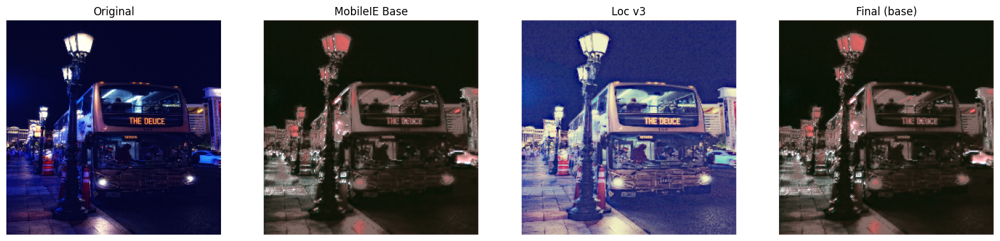


📌 圖片： /content/contrast_dataset/ExDark/Chair/2015_04078.jpg
mean_o=0.248, contrast_o=0.208
bright_o=0.016, bright_b=0.000, bright_l=0.018
bright_spread=-0.016
edge_o=0.143, edge_b=0.078, edge_l=0.158
edge_loss_base=0.459, edge_loss_loc=-0.103
👉 AutoSelect v4 模式：loc_v3


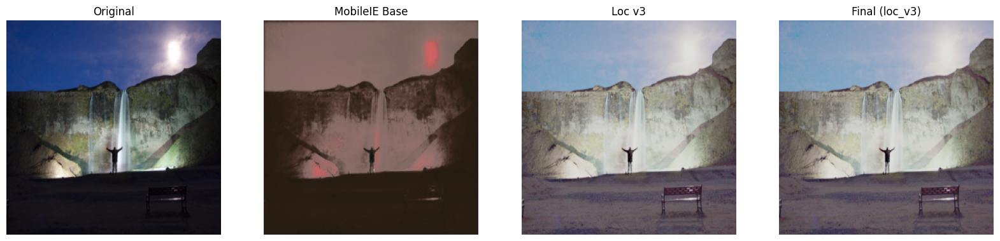


📌 圖片： /content/contrast_dataset/ExDark/Bottle/2015_01638.jpg
mean_o=0.355, contrast_o=0.203
bright_o=0.000, bright_b=0.689, bright_l=0.000
bright_spread=0.689
edge_o=0.125, edge_b=0.127, edge_l=0.081
edge_loss_base=-0.012, edge_loss_loc=0.352
👉 AutoSelect v4 模式：loc_v3


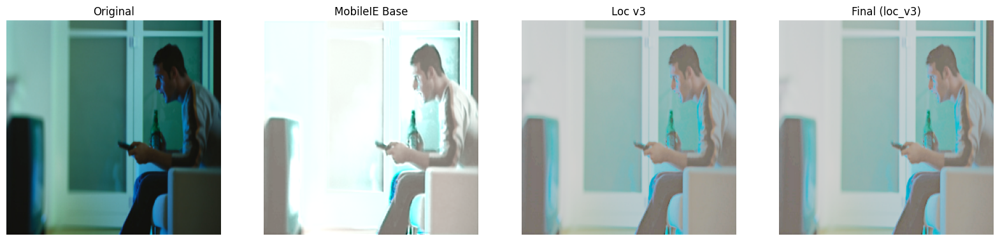


📌 圖片： /content/contrast_dataset/ExDark/Bus/2015_01915.jpg
mean_o=0.208, contrast_o=0.157
bright_o=0.010, bright_b=0.125, bright_l=0.011
bright_spread=0.115
edge_o=0.194, edge_b=0.222, edge_l=0.144
edge_loss_base=-0.142, edge_loss_loc=0.259
👉 AutoSelect v4 模式：loc_v3


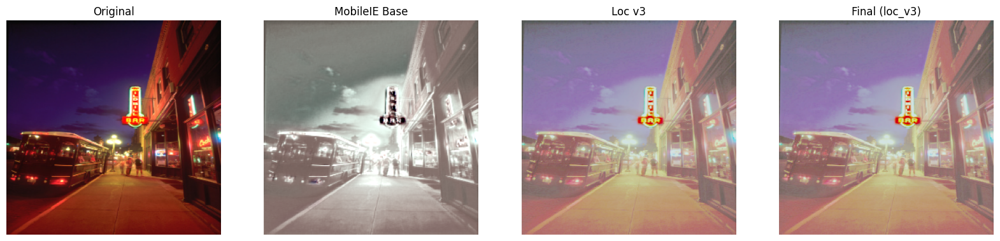


📌 圖片： /content/contrast_dataset/ExDark/Bicycle/2015_00298.jpg
mean_o=0.029, contrast_o=0.126
bright_o=0.004, bright_b=0.044, bright_l=0.003
bright_spread=0.040
edge_o=0.085, edge_b=0.165, edge_l=0.142
edge_loss_base=-0.948, edge_loss_loc=-0.682
👉 AutoSelect v4 模式：base


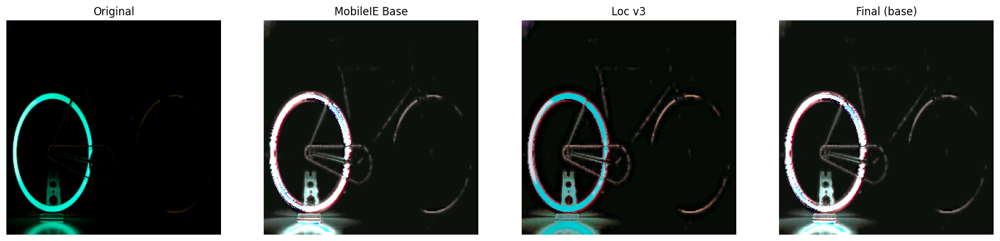


📌 圖片： /content/contrast_dataset/ExDark/Cat/2015_03117.jpg
mean_o=0.192, contrast_o=0.121
bright_o=0.000, bright_b=0.001, bright_l=0.001
bright_spread=0.001
edge_o=0.222, edge_b=0.179, edge_l=0.345
edge_loss_base=0.195, edge_loss_loc=-0.556
👉 AutoSelect v4 模式：base


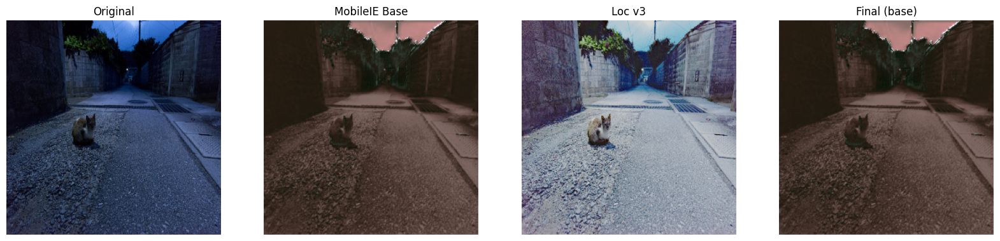


📌 圖片： /content/contrast_dataset/ExDark/Bicycle/2015_00245.jpg
mean_o=0.187, contrast_o=0.201
bright_o=0.030, bright_b=0.110, bright_l=0.024
bright_spread=0.080
edge_o=0.279, edge_b=0.309, edge_l=0.256
edge_loss_base=-0.110, edge_loss_loc=0.082
👉 AutoSelect v4 模式：loc_v3


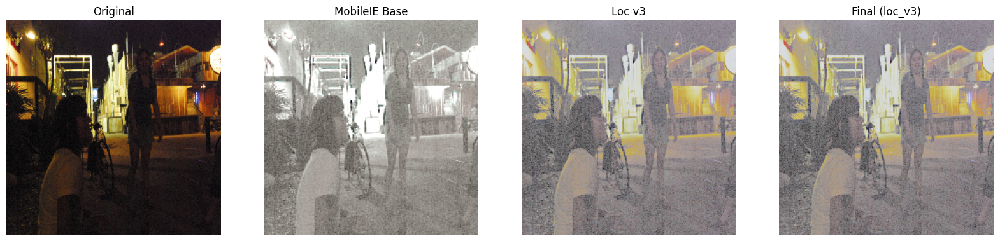


📌 圖片： /content/contrast_dataset/ExDark/Cat/2015_03094.jpg
mean_o=0.186, contrast_o=0.202
bright_o=0.011, bright_b=0.228, bright_l=0.014
bright_spread=0.217
edge_o=0.252, edge_b=0.320, edge_l=0.261
edge_loss_base=-0.270, edge_loss_loc=-0.035
👉 AutoSelect v4 模式：loc_v3


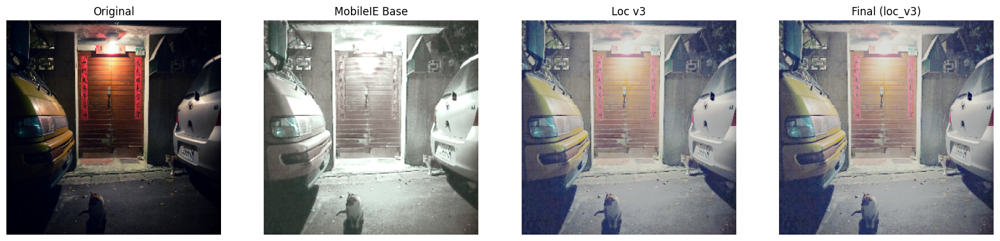


📌 圖片： /content/contrast_dataset/ExDark/Bottle/2015_01679.jpg
mean_o=0.165, contrast_o=0.204
bright_o=0.017, bright_b=0.110, bright_l=0.012
bright_spread=0.093
edge_o=0.413, edge_b=0.495, edge_l=0.434
edge_loss_base=-0.196, edge_loss_loc=-0.050
👉 AutoSelect v4 模式：loc_v3


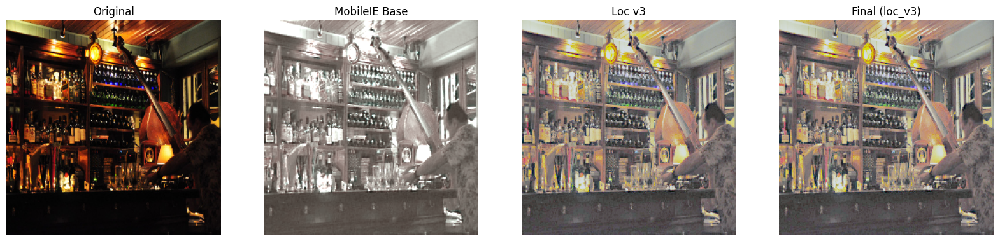


📌 圖片： /content/contrast_dataset/ExDark/People/2015_06388.jpg
mean_o=0.141, contrast_o=0.226
bright_o=0.038, bright_b=0.135, bright_l=0.036
bright_spread=0.097
edge_o=0.266, edge_b=0.502, edge_l=0.472
edge_loss_base=-0.887, edge_loss_loc=-0.774
👉 AutoSelect v4 模式：loc_v3


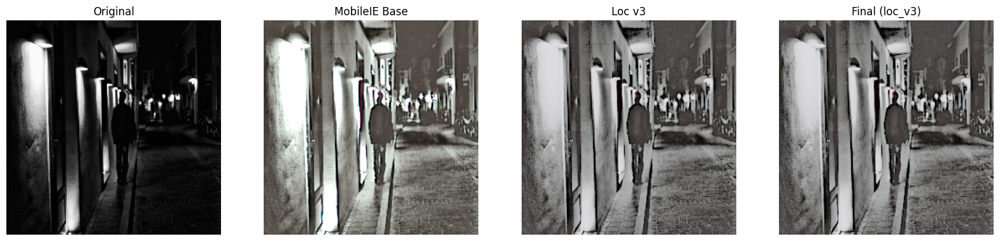

In [11]:
exdark_root = "/content/contrast_dataset/ExDark"
paths = []
for cls in os.listdir(exdark_root):
    d = os.path.join(exdark_root, cls)
    if os.path.isdir(d):
        paths += glob.glob(d + "/*.jpg") + glob.glob(d + "/*.png")

print("ExDark 圖片數：", len(paths))
for p in random.sample(paths, 10):
    show_compare(p, resize_to=256)


LOLv2 Test/Low 圖片數： 100

📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00730.png
mean_o=0.141, contrast_o=0.106
bright_o=0.000, bright_b=0.071, bright_l=0.000
bright_spread=0.071
edge_o=0.071, edge_b=0.163, edge_l=0.139
edge_loss_base=-1.291, edge_loss_loc=-0.949
👉 AutoSelect v4 模式：loc_v3


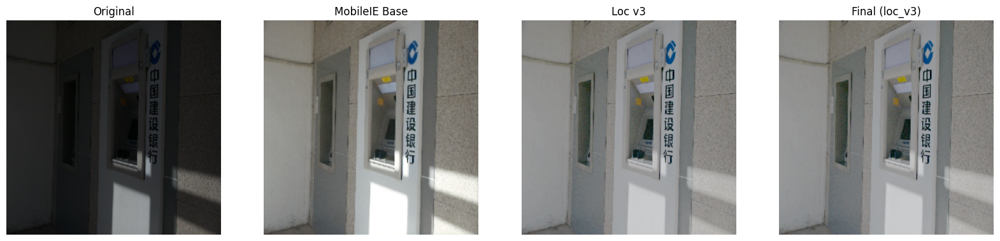


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00767.png
mean_o=0.019, contrast_o=0.033
bright_o=0.000, bright_b=0.016, bright_l=0.000
bright_spread=0.016
edge_o=0.041, edge_b=0.231, edge_l=0.252
edge_loss_base=-4.588, edge_loss_loc=-5.083
👉 AutoSelect v4 模式：loc_v3


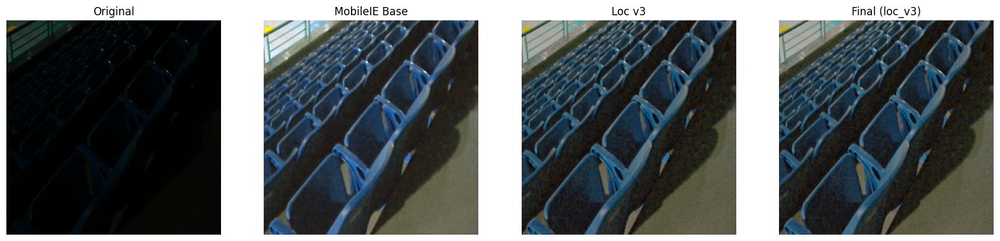


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00774.png
mean_o=0.028, contrast_o=0.023
bright_o=0.000, bright_b=0.000, bright_l=0.000
bright_spread=0.000
edge_o=0.035, edge_b=0.182, edge_l=0.175
edge_loss_base=-4.254, edge_loss_loc=-4.062
👉 AutoSelect v4 模式：loc_v3


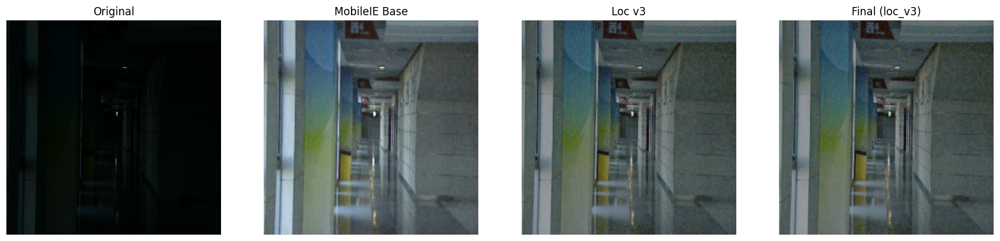


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00721.png
mean_o=0.041, contrast_o=0.028
bright_o=0.000, bright_b=0.000, bright_l=0.000
bright_spread=0.000
edge_o=0.063, edge_b=0.290, edge_l=0.308
edge_loss_base=-3.617, edge_loss_loc=-3.900
👉 AutoSelect v4 模式：loc_v3


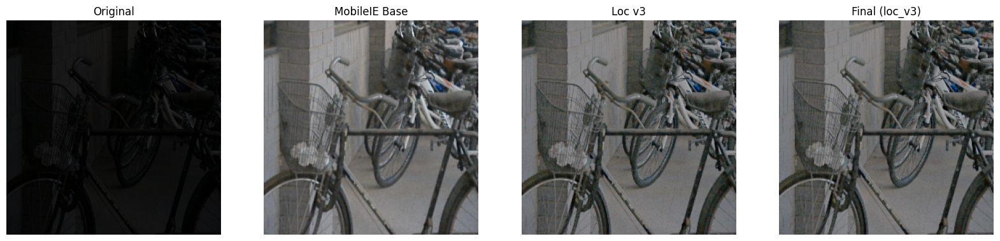


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00703.png
mean_o=0.039, contrast_o=0.028
bright_o=0.000, bright_b=0.073, bright_l=0.000
bright_spread=0.073
edge_o=0.034, edge_b=0.187, edge_l=0.142
edge_loss_base=-4.569, edge_loss_loc=-3.231
👉 AutoSelect v4 模式：loc_v3


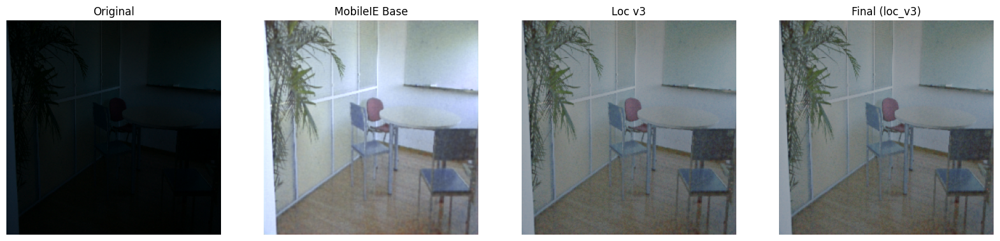


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00711.png
mean_o=0.120, contrast_o=0.121
bright_o=0.000, bright_b=0.143, bright_l=0.000
bright_spread=0.143
edge_o=0.067, edge_b=0.156, edge_l=0.138
edge_loss_base=-1.344, edge_loss_loc=-1.070
👉 AutoSelect v4 模式：loc_v3


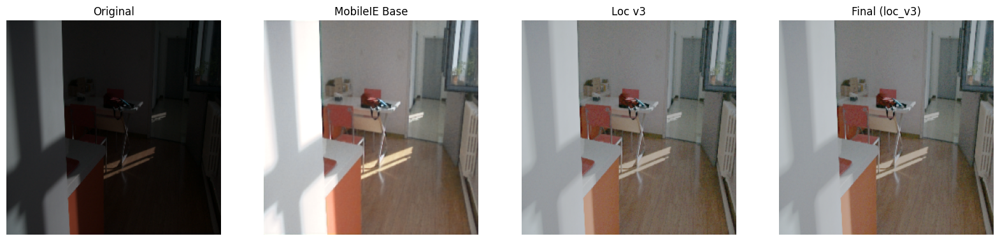


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00769.png
mean_o=0.040, contrast_o=0.066
bright_o=0.000, bright_b=0.014, bright_l=0.000
bright_spread=0.014
edge_o=0.060, edge_b=0.150, edge_l=0.196
edge_loss_base=-1.477, edge_loss_loc=-2.241
👉 AutoSelect v4 模式：base


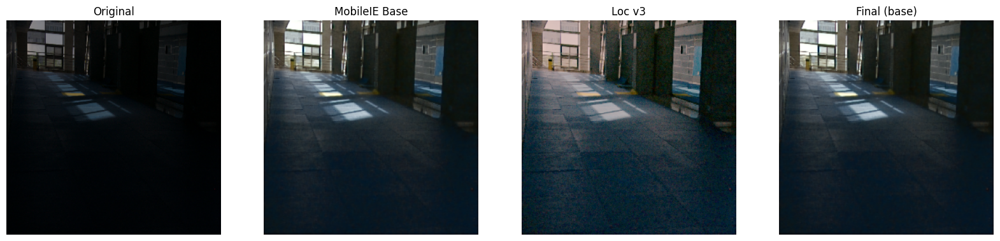


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00777.png
mean_o=0.031, contrast_o=0.031
bright_o=0.000, bright_b=0.002, bright_l=0.000
bright_spread=0.002
edge_o=0.050, edge_b=0.248, edge_l=0.252
edge_loss_base=-4.002, edge_loss_loc=-4.080
👉 AutoSelect v4 模式：loc_v3


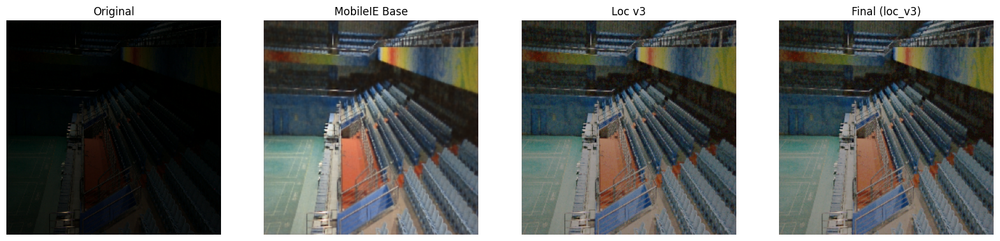


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00785.png
mean_o=0.028, contrast_o=0.032
bright_o=0.000, bright_b=0.039, bright_l=0.000
bright_spread=0.039
edge_o=0.054, edge_b=0.297, edge_l=0.268
edge_loss_base=-4.556, edge_loss_loc=-4.015
👉 AutoSelect v4 模式：loc_v3


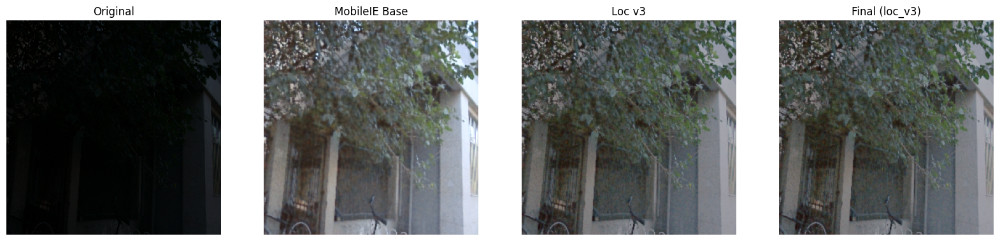


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00718.png
mean_o=0.130, contrast_o=0.119
bright_o=0.000, bright_b=0.136, bright_l=0.000
bright_spread=0.136
edge_o=0.109, edge_b=0.227, edge_l=0.220
edge_loss_base=-1.071, edge_loss_loc=-1.015
👉 AutoSelect v4 模式：loc_v3


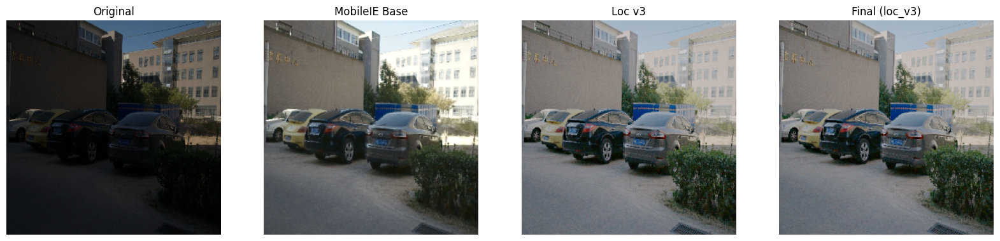

In [ ]:
lolv2_root = "/content/LOLv2/LOL-v2/Real_captured/Test/Low"
all_imgs = glob.glob(lolv2_root + "/*.png")
print("LOLv2 Test/Low 圖片數：", len(all_imgs))

for p in random.sample(all_imgs, 10):
    show_compare(p, resize_to=256)



📌 圖片： /content/constract_1.png
mean_o=0.145, contrast_o=0.157
bright_o=0.002, bright_b=0.115, bright_l=0.003
bright_spread=0.114
edge_o=0.237, edge_b=0.299, edge_l=0.222
edge_loss_base=-0.258, edge_loss_loc=0.065
👉 AutoSelect v4 模式：loc_v3


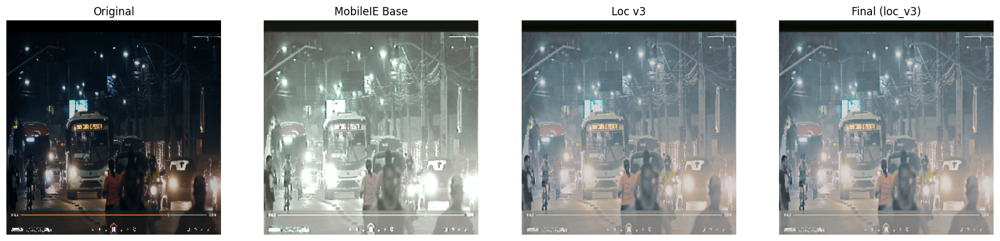


📌 圖片： /content/constract_2.png
mean_o=0.113, contrast_o=0.111
bright_o=0.002, bright_b=0.047, bright_l=0.002
bright_spread=0.045
edge_o=0.125, edge_b=0.158, edge_l=0.130
edge_loss_base=-0.266, edge_loss_loc=-0.041
👉 AutoSelect v4 模式：loc_v3


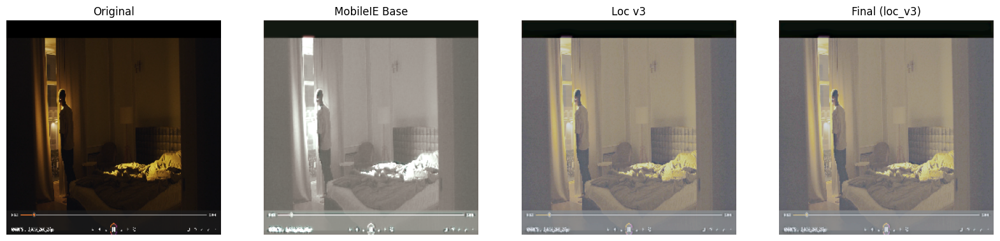

In [ ]:
show_compare("/content/constract_1.png", resize_to=256)
show_compare("/content/constract_2.png", resize_to=256)


# Model_Best.pkl


# 改寫lle.py

In [ ]:
new_code = """
import torch.nn as nn
import torch
from .utils import (
    MBRConv5,
    MBRConv3,
    MBRConv1,
    DropBlock,
    FST,
    FSTS,
)
import torch.fft as fft


class MobileIELLENet(nn.Module):
    def __init__(self, channels, rep_scale=4):
        super(MobileIELLENet, self).__init__()
        self.channels = channels
        self.head = FST(
            nn.Sequential(
                MBRConv5(3, channels, rep_scale=rep_scale),
                nn.PReLU(channels),
                MBRConv3(channels, channels, rep_scale=rep_scale)
            ),
            channels
        )
        self.body = FST(
            MBRConv3(channels, channels, rep_scale=rep_scale),
            channels
        )
        # self.att = nn.Sequential(
        #     nn.AdaptiveAvgPool2d(1),
        #     MBRConv1(channels, channels, rep_scale=rep_scale),
        #     nn.Sigmoid()
        # )
        # self.att1= nn.Sequential(
        #     MBRConv1(1, channels, rep_scale=rep_scale),
        #     nn.Sigmoid()
        # )
        self.att = FGHDPA(channels, rep_scale=rep_scale)

        self.tail = MBRConv3(channels, 3, rep_scale=rep_scale)
        self.tail_warm = MBRConv3(channels, 3, rep_scale=rep_scale)
        self.drop = DropBlock(3)

    def forward(self, x):
        x0 = self.head(x)
        x1 = self.body(x0)
        # x2 = self.att(x1)
        # max_out, _ = torch.max(x2 * x1 , dim=1, keepdim=True)
        # x3 = self.att1(max_out)
        # x4 = torch.mul(x2, x3) * x1
        # return self.tail(x4)
        x2 = self.att(x1)    # FG-HDPA output = attention_applied_feature
        return self.tail(x2)


    def forward_warm(self, x):
        x = self.drop(x)
        x = self.head(x)
        x = self.body(x)
        return self.tail(x), self.tail_warm(x)

    def slim(self):
        net_slim = MobileIELLENetS(self.channels)
        weight_slim = net_slim.state_dict()
        for name, mod in self.named_modules():
            if isinstance(mod, MBRConv3) or isinstance(mod, MBRConv5) or isinstance(mod, MBRConv1):
               if '%s.weight' % name in weight_slim:
                    w, b = mod.slim()
                    weight_slim['%s.weight' % name] = w
                    weight_slim['%s.bias' % name] = b
            elif isinstance(mod, FST):
                weight_slim['%s.bias' % name] = mod.bias
                weight_slim['%s.weight1' % name] = mod.weight1
                weight_slim['%s.weight2' % name] = mod.weight2
            elif isinstance(mod, nn.PReLU):
                weight_slim['%s.weight' % name] = mod.weight
        net_slim.load_state_dict(weight_slim)
        return net_slim

class MobileIELLENetS(nn.Module):
    def __init__(self, channels):
        super(MobileIELLENetS, self).__init__()
        self.head = FSTS(
            nn.Sequential(
                nn.Conv2d(3, channels, 5, 1, 2),
                nn.PReLU(channels),
                nn.Conv2d(channels, channels, 3, 1, 1)
            ),
            channels
        )
        self.body = FSTS(
            nn.Conv2d(channels, channels, 3, 1, 1),
            channels
        )
        self.att = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(channels, channels, 1),
            nn.Sigmoid()
        )
        self.att1 = nn.Sequential(
            nn.Conv2d(1, channels, 1, 1),
            nn.Sigmoid()
        )
        self.tail = nn.Conv2d(channels, 3, 3, 1, 1)

    def forward(self, x):
        x0 = self.head(x)
        x1 = self.body(x0)
        x2 = self.att(x1)
        max_out, _ = torch.max(x2 * x1, dim=1, keepdim=True)
        x3 = self.att1(max_out)
        x4 = torch.mul(x3, x2) * x1
        return self.tail(x4)


class FGHDPA(nn.Module):
    def __init__(self, channels, rep_scale=4):
        super(FGHDPA, self).__init__()

        # 將 concat(x_spatial, x_freq) 投影回 channel attention
        self.fc = nn.Sequential(
            nn.Conv2d(channels * 2, channels // 4, 1),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels // 4, channels, 1),
            nn.Sigmoid()
        )

        # local path 不動，但要包成 conv1x1（使用原本 MBRConv1）
        self.local = nn.Sequential(
            MBRConv1(1, channels, rep_scale=rep_scale),
            nn.Sigmoid()
        )

    def forward(self, F):
        # ------------------------------
        # 1. Spatial global descriptor
        # ------------------------------
        g_spatial = torch.mean(F, dim=[2,3], keepdim=True)   # GAP(F)

        # ------------------------------
        # 2. Frequency descriptor (DCT / FFT)
        # ------------------------------
        # 使用 FFT 的 magnitude 當頻域特徵（效果好且簡單）
        F_freq = torch.abs(fft.rfft2(F, norm="ortho"))

        # rfft2 會縮小維度 → 需要 interpolate 回原大小
        F_freq = torch.nn.functional.interpolate(
            F_freq, size=F.shape[2:], mode="bilinear", align_corners=False
        )

        g_freq = torch.mean(F_freq, dim=[2,3], keepdim=True) # GAP(DCT/Frequency)

        # ------------------------------
        # 3. Concatenate descriptors
        # ------------------------------
        g = torch.cat([g_spatial, g_freq], dim=1)  # (B, 2C, 1, 1)

        # ------------------------------
        # 4. Global attention Ag
        # ------------------------------
        Ag = self.fc(g)   # (B, C, 1, 1)
        Fg = Ag * F

        # ------------------------------
        # 5. Local attention     Al
        # ------------------------------
        max_out, _ = torch.max(Fg, dim=1, keepdim=True)  # (B,1,H,W)
        Al = self.local(max_out)

        # ------------------------------
        # 6. Final output
        # ------------------------------
        A = Ag * Al
        return A * F


"""

with open("/content/MobileIE/model/lle.py", "w") as f:
    f.write(new_code)

print("✔ lle.py 已成功更新")


✔ lle.py 已成功更新


In [ ]:
from importlib import reload
import model.lle
reload(model.lle)
print("✔ lle.py reloaded")


✔ lle.py reloaded


inference

In [ ]:
# ---------------------------
# 1. 載入 MobileIE Full 模型
# ---------------------------
import sys
sys.path.append("/content/MobileIE")

from model.lle import MobileIELLENet   # ★ 使用 Full 模型，而不是 Slim！
device = "cuda" if torch.cuda.is_available() else "cpu"
print("使用裝置：", device)

# ★ 使用 Full 模型結構
mobileie = MobileIELLENet(channels=12)

# ★ 載入組員訓練的權重
state = torch.load("/content/model_best.pkl", map_location=device)

# ★ strict=False：避免 tail_warm、conv_bn 等 Full model 內的額外層 mismatch
mobileie.load_state_dict(state, strict=False)

mobileie = mobileie.to(device).eval()
for p in mobileie.parameters():
    p.requires_grad = False

print("✔ MobileIE Full 模型載入成功！")


使用裝置： cuda
✔ MobileIE Full 模型載入成功！


In [ ]:

# ---------------------------
# 2. Baseline 推論
# ---------------------------
def run_baseline(img_rgb):
    """MobileIE 原始輸出"""
    t = to_tensor(img_rgb.copy()).unsqueeze(0).to(device)
    with torch.no_grad():
        out = mobileie(t).clamp(0,1)[0].cpu()
    return np.array(to_pil_image(out)).astype(np.uint8)


# ---------------------------
# 3. Loc v3 — 暗部增亮 + 對比補償 + 高光保護
# ---------------------------
def smoothstep(e0, e1, x):
    t = np.clip((x - e0) / (e1 - e0), 0, 1)
    return t * t * (3 - 2 * t)

def dark_mask(img_rgb, dark_thr=0.55, low=0.20, high=0.65):
    """生成暗部 soft mask：暗的地方為 1，亮部接近 0"""
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY) / 255.0
    inv = np.clip((dark_thr - gray) / dark_thr, 0, 1)
    m = smoothstep(low, high, inv)
    return np.stack([m]*3, axis=-1)

def restore_local_contrast(img_rgb, amount=0.12, sigma=4.0):
    """簡單 local contrast（unsharp mask）"""
    blur = cv2.GaussianBlur(img_rgb, (0,0), sigmaX=sigma)
    out  = img_rgb.astype(np.float32) + amount * (img_rgb.astype(np.float32) - blur.astype(np.float32))
    return np.clip(out, 0, 255).astype(np.uint8)

def protect_highlights(img_rgb, strength=0.25):
    """壓一下高光，避免太死白；類似 HDR tone mapping"""
    img_f = img_rgb.astype(np.float32) / 255.0
    out   = img_f / (img_f + strength)   # x / (x + c)
    return np.clip(out * 255.0, 0, 255).astype(np.uint8)

def gray_world_balance(img_rgb, mix=0.4):
    """簡單防偏色：讓三通道平均值接近"""
    img = img_rgb.astype(np.float32)
    mean_c = img.mean(axis=(0,1), keepdims=True) + 1e-6
    mean_all = img.mean() + 1e-6
    gain = mean_all / mean_c   # R/G/B 各自調整
    balanced = img * (1.0 * (1-mix) + gain * mix)
    return np.clip(balanced, 0, 255).astype(np.uint8)

def run_loc_v3(original_rgb,
               boost_strength=0.16,   # 原本 0.24 → 降低增亮幅度
               dark_thr=0.48,         # 原本 0.55~0.65 → 降低「暗部」覆蓋
               low=0.20,
               high=0.70):            # 讓 mask 更柔和
    base = run_baseline(original_rgb)

    mask = dark_mask(original_rgb, dark_thr, low, high)
    diff = base.astype(np.float32) - original_rgb.astype(np.float32)

    # (1) 暗部增亮（弱化）
    out = original_rgb.astype(np.float32) + mask * diff * boost_strength
    out = np.clip(out, 0, 255).astype(np.uint8)

    # (2) 對比恢復（強化）
    out = restore_local_contrast(out, amount=0.15, sigma=4.0)

    # (3) 高光保留（弱化壓制）
    out = protect_highlights(out, strength=0.15)

    # (4) 防偏色（降低強度）
    out = gray_world_balance(out, mix=0.30)

    return out, base



# ---------------------------
# 4. AutoSelect v4 — 更聰明選擇 base / loc_v3
# ---------------------------
def compute_gray(img_rgb):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY) / 255.0
    return gray.astype(np.float32)   # ★ 加這行


def edge_strength(gray):
    """Sobel 邊緣強度"""
    gray = gray.astype(np.float32)   # ★★★ 強制處理 dtype
    gx = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=3)
    mag = np.sqrt(gx*gx + gy*gy)
    return float(mag.mean())


def auto_select_v4(original_rgb, base_rgb, loc_rgb):
    """
    AutoSelect v4.2 — 加入 baseline failure detection：
        ✔ baseline 色偏過大
        ✔ baseline 變負片（大部分比原圖還暗）
        ✔ baseline 爆白太多
    若偵測異常 → 強制使用 loc_v3
    """

    # ---------- 基本灰階 ----------
    g_o = compute_gray(original_rgb)
    g_b = compute_gray(base_rgb)
    g_l = compute_gray(loc_rgb)

    # ========== 基礎統計 ==========
    mean_o = float(g_o.mean())
    bright_o = float((g_o > 0.85).mean())
    contrast_o = float(g_o.std())

    mean_b = float(g_b.mean())
    bright_b = float((g_b > 0.85).mean())
    contrast_b = float(g_b.std())

    mean_l = float(g_l.mean())
    bright_l = float((g_l > 0.85).mean())
    contrast_l = float(g_l.std())

    # ---------- baseline 的亮部擴散 ----------
    bright_spread = bright_b - bright_o

    # ---------- 邊緣指標 ----------
    edge_o = edge_strength(g_o)
    edge_b = edge_strength(g_b)
    edge_l = edge_strength(g_l)

    edge_loss_base = (edge_o - edge_b) / max(edge_o, 1e-6)
    edge_loss_loc  = (edge_o - edge_l) / max(edge_o, 1e-6)

    # ===================================================================
    #  NEW: Baseline Failure Detection（核心改善）
    # ===================================================================

    # (A) baseline 與原圖差異太大 → 偏色 or 光調崩壞
    color_shift = np.mean(np.abs(base_rgb.astype(float) - original_rgb.astype(float)) / 255.0)

    # (B) baseline 變負片 → 大部分像素比原圖更暗
    neg_score = np.mean(base_rgb.mean(axis=2) < original_rgb.mean(axis=2))

    # (C) baseline 過曝（太白）
    over_b = np.mean(base_rgb > 245)

    baseline_fail = (
        (color_shift > 0.22) or   # 色偏過大
        (neg_score > 0.60) or     # 類負片
        (over_b > 0.25)           # 超過 25% 過曝
    )

    if baseline_fail:
        mode = "loc_v3"
    else:
        # ===================================================================
        # 既有邏輯（保留你的 v4，但更穩定）
        # ===================================================================

        if bright_spread > 0.10 and contrast_o > 0.18:
            mode = "loc_v3"

        elif edge_loss_base > 0.25:
            mode = "loc_v3"

        elif contrast_l < 0.6 * contrast_o:
            mode = "base"

        elif mean_o < 0.22 and bright_b > 0.12:
            mode = "loc_v3"

        else:
            mode = "base"

    # 最終選擇
    final = loc_rgb if mode == "loc_v3" else base_rgb

    # 回傳 debug 資訊
    info = dict(
        mean_o=mean_o, mean_b=mean_b, mean_l=mean_l,
        bright_o=bright_o, bright_b=bright_b, bright_l=bright_l,
        contrast_o=contrast_o, contrast_b=contrast_b, contrast_l=contrast_l,
        bright_spread=bright_spread,
        edge_o=edge_o, edge_b=edge_b, edge_l=edge_l,
        edge_loss_base=edge_loss_base,
        edge_loss_loc=edge_loss_loc,
        color_shift=color_shift,
        neg_score=neg_score,
        over_b=over_b,
        baseline_fail=baseline_fail
    )

    return final, mode, info



# ---------------------------
# 5. 單張圖片：compare 四圖
# ---------------------------
def show_compare(path, resize_to=None):
    bgr = cv2.imread(path)
    if bgr is None:
        print("❌ 無法讀取圖片：", path)
        return
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    if resize_to is not None:
        rgb = cv2.resize(rgb, (resize_to, resize_to))

    loc3, base = run_loc_v3(rgb)
    final, mode, info = auto_select_v4(rgb, base, loc3)

    print("\n==============================")
    print("📌 圖片：", path)
    print(f"mean_o={info['mean_o']:.3f}, contrast_o={info['contrast_o']:.3f}")
    print(f"bright_o={info['bright_o']:.3f}, bright_b={info['bright_b']:.3f}, bright_l={info['bright_l']:.3f}")
    print(f"bright_spread={info['bright_spread']:.3f}")
    print(f"edge_o={info['edge_o']:.3f}, edge_b={info['edge_b']:.3f}, edge_l={info['edge_l']:.3f}")
    print(f"edge_loss_base={info['edge_loss_base']:.3f}, edge_loss_loc={info['edge_loss_loc']:.3f}")
    print(f"👉 AutoSelect v4 模式：{mode}")
    print("==============================")

    plt.figure(figsize=(20,6))
    plt.subplot(1,4,1); plt.imshow(rgb);  plt.title("Original");        plt.axis("off")
    plt.subplot(1,4,2); plt.imshow(base); plt.title("MobileIE Base");   plt.axis("off")
    plt.subplot(1,4,3); plt.imshow(loc3); plt.title("Loc v3");          plt.axis("off")
    plt.subplot(1,4,4); plt.imshow(final);plt.title(f"Final ({mode})"); plt.axis("off")
    plt.show()


print("\n✅ Loc v3 + AutoSelect v4 已設定完成，你可以用 show_compare() 來測圖。")



✅ Loc v3 + AutoSelect v4 已設定完成，你可以用 show_compare() 來測圖。


ExDark 圖片數： 6691

📌 圖片： /content/contrast_dataset/ExDark/Cup/2015_04530.jpg
mean_o=0.085, contrast_o=0.109
bright_o=0.002, bright_b=0.205, bright_l=0.002
bright_spread=0.203
edge_o=0.107, edge_b=0.245, edge_l=0.172
edge_loss_base=-1.300, edge_loss_loc=-0.608
👉 AutoSelect v4 模式：loc_v3


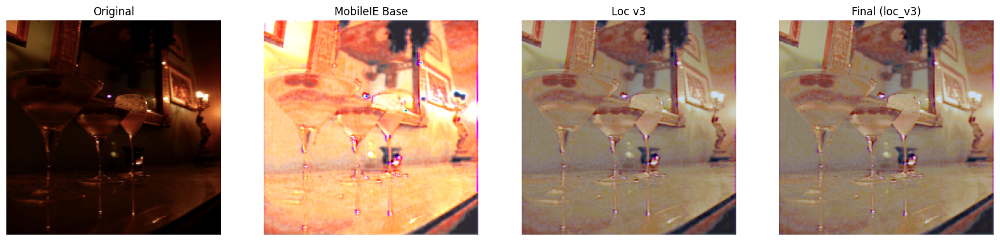


📌 圖片： /content/contrast_dataset/ExDark/Bicycle/2015_00120.jpg
mean_o=0.132, contrast_o=0.225
bright_o=0.025, bright_b=0.255, bright_l=0.033
bright_spread=0.230
edge_o=0.469, edge_b=0.760, edge_l=0.666
edge_loss_base=-0.621, edge_loss_loc=-0.422
👉 AutoSelect v4 模式：loc_v3


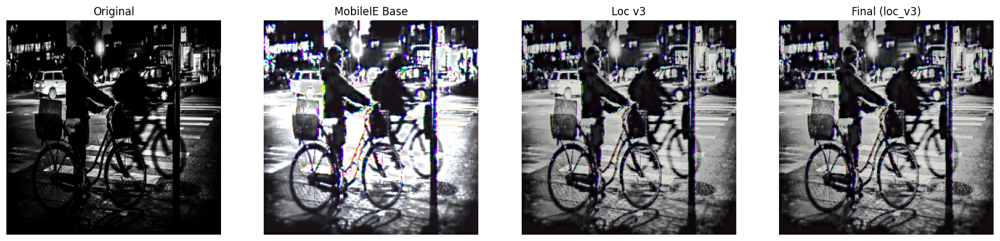


📌 圖片： /content/contrast_dataset/ExDark/Bus/2015_02236.jpg
mean_o=0.117, contrast_o=0.121
bright_o=0.009, bright_b=0.060, bright_l=0.010
bright_spread=0.052
edge_o=0.187, edge_b=0.482, edge_l=0.393
edge_loss_base=-1.571, edge_loss_loc=-1.095
👉 AutoSelect v4 模式：loc_v3


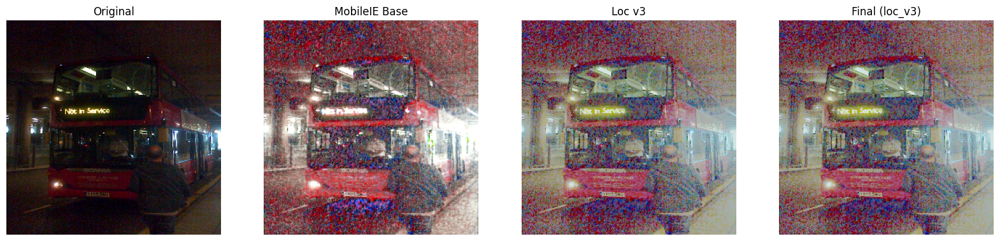


📌 圖片： /content/contrast_dataset/ExDark/Bus/2015_02042.jpg
mean_o=0.203, contrast_o=0.203
bright_o=0.011, bright_b=0.530, bright_l=0.020
bright_spread=0.519
edge_o=0.277, edge_b=0.362, edge_l=0.284
edge_loss_base=-0.309, edge_loss_loc=-0.026
👉 AutoSelect v4 模式：loc_v3


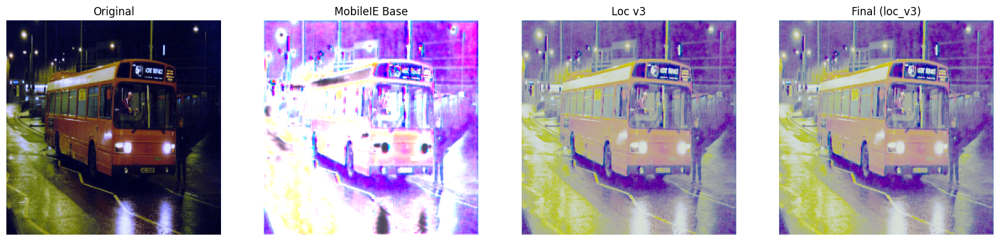


📌 圖片： /content/contrast_dataset/ExDark/Motorbike/2015_05941.jpg
mean_o=0.080, contrast_o=0.053
bright_o=0.000, bright_b=0.002, bright_l=0.000
bright_spread=0.002
edge_o=0.067, edge_b=0.216, edge_l=0.215
edge_loss_base=-2.249, edge_loss_loc=-2.233
👉 AutoSelect v4 模式：loc_v3


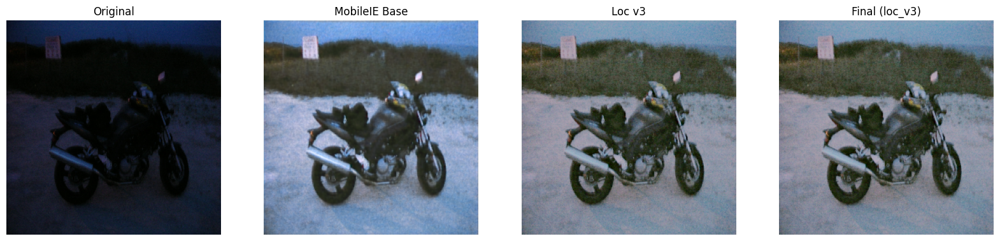


📌 圖片： /content/contrast_dataset/ExDark/Car/2015_02944.jpg
mean_o=0.127, contrast_o=0.106
bright_o=0.003, bright_b=0.078, bright_l=0.003
bright_spread=0.075
edge_o=0.090, edge_b=0.139, edge_l=0.138
edge_loss_base=-0.535, edge_loss_loc=-0.525
👉 AutoSelect v4 模式：loc_v3


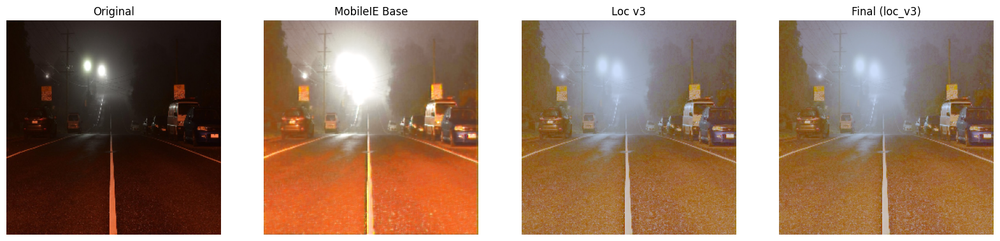


📌 圖片： /content/contrast_dataset/ExDark/Boat/2015_01270.jpg
mean_o=0.163, contrast_o=0.145
bright_o=0.000, bright_b=0.299, bright_l=0.000
bright_spread=0.299
edge_o=0.124, edge_b=0.267, edge_l=0.264
edge_loss_base=-1.151, edge_loss_loc=-1.126
👉 AutoSelect v4 模式：loc_v3


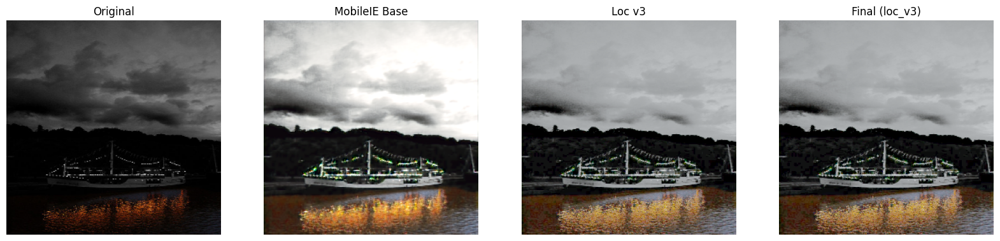


📌 圖片： /content/contrast_dataset/ExDark/Dog/2015_05621.jpg
mean_o=0.064, contrast_o=0.036
bright_o=0.000, bright_b=0.006, bright_l=0.000
bright_spread=0.006
edge_o=0.065, edge_b=0.199, edge_l=0.188
edge_loss_base=-2.041, edge_loss_loc=-1.867
👉 AutoSelect v4 模式：loc_v3


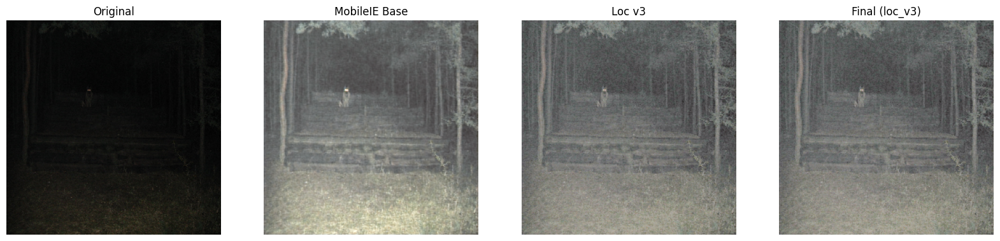


📌 圖片： /content/contrast_dataset/ExDark/Boat/2015_00808.jpg
mean_o=0.120, contrast_o=0.116
bright_o=0.000, bright_b=0.106, bright_l=0.000
bright_spread=0.106
edge_o=0.073, edge_b=0.153, edge_l=0.158
edge_loss_base=-1.088, edge_loss_loc=-1.163
👉 AutoSelect v4 模式：loc_v3


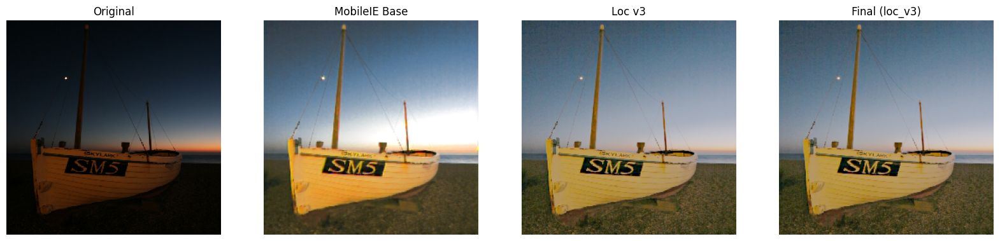


📌 圖片： /content/contrast_dataset/ExDark/Car/2015_02791.jpg
mean_o=0.163, contrast_o=0.132
bright_o=0.008, bright_b=0.044, bright_l=0.001
bright_spread=0.036
edge_o=0.149, edge_b=0.197, edge_l=0.156
edge_loss_base=-0.315, edge_loss_loc=-0.044
👉 AutoSelect v4 模式：loc_v3


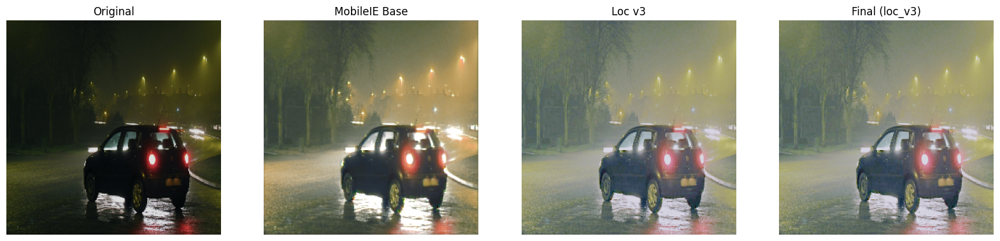

In [ ]:
exdark_root = "/content/contrast_dataset/ExDark"
paths = []
for cls in os.listdir(exdark_root):
    d = os.path.join(exdark_root, cls)
    if os.path.isdir(d):
        paths += glob.glob(d + "/*.jpg") + glob.glob(d + "/*.png")

print("ExDark 圖片數：", len(paths))
for p in random.sample(paths, 10):
    show_compare(p, resize_to=256)


LOLv2 Test/Low 圖片數： 100

📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00710.png
mean_o=0.120, contrast_o=0.122
bright_o=0.000, bright_b=0.141, bright_l=0.000
bright_spread=0.141
edge_o=0.067, edge_b=0.155, edge_l=0.143
edge_loss_base=-1.328, edge_loss_loc=-1.153
👉 AutoSelect v4 模式：loc_v3


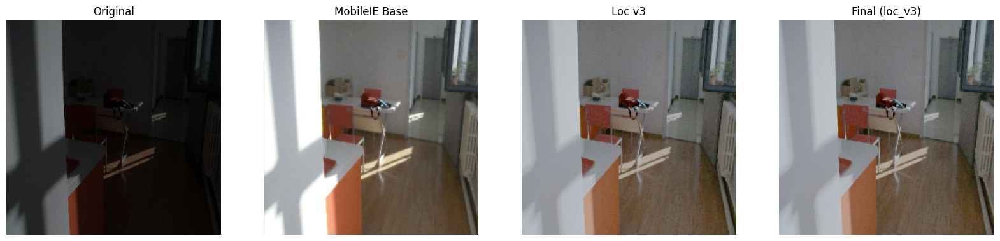


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00701.png
mean_o=0.084, contrast_o=0.052
bright_o=0.001, bright_b=0.002, bright_l=0.001
bright_spread=0.001
edge_o=0.057, edge_b=0.159, edge_l=0.175
edge_loss_base=-1.810, edge_loss_loc=-2.088
👉 AutoSelect v4 模式：loc_v3


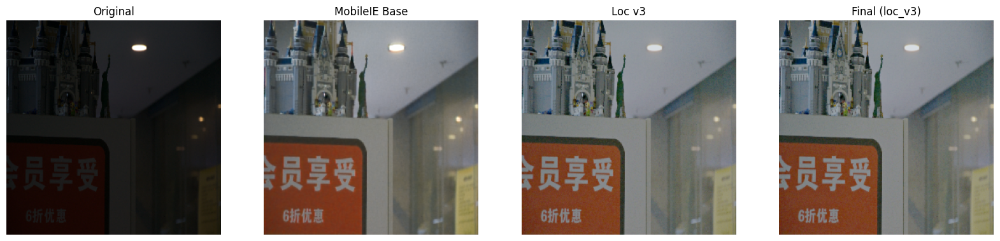


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00700.png
mean_o=0.084, contrast_o=0.052
bright_o=0.001, bright_b=0.002, bright_l=0.001
bright_spread=0.001
edge_o=0.057, edge_b=0.157, edge_l=0.176
edge_loss_base=-1.771, edge_loss_loc=-2.109
👉 AutoSelect v4 模式：loc_v3


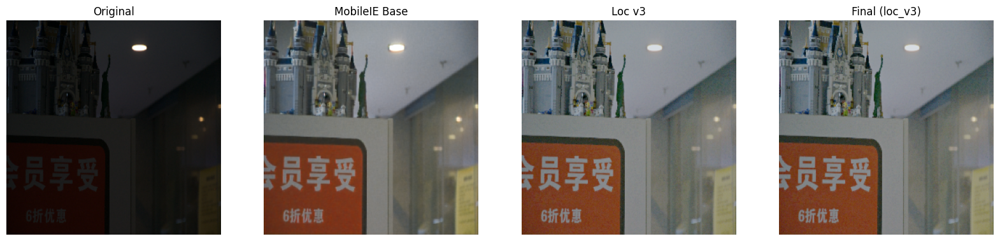


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00692.png
mean_o=0.042, contrast_o=0.028
bright_o=0.000, bright_b=0.000, bright_l=0.000
bright_spread=0.000
edge_o=0.056, edge_b=0.244, edge_l=0.272
edge_loss_base=-3.386, edge_loss_loc=-3.899
👉 AutoSelect v4 模式：loc_v3


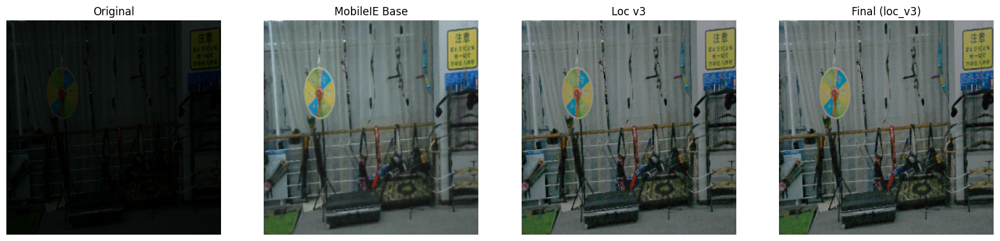


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00755.png
mean_o=0.021, contrast_o=0.011
bright_o=0.000, bright_b=0.000, bright_l=0.000
bright_spread=0.000
edge_o=0.024, edge_b=0.132, edge_l=0.150
edge_loss_base=-4.537, edge_loss_loc=-5.295
👉 AutoSelect v4 模式：loc_v3


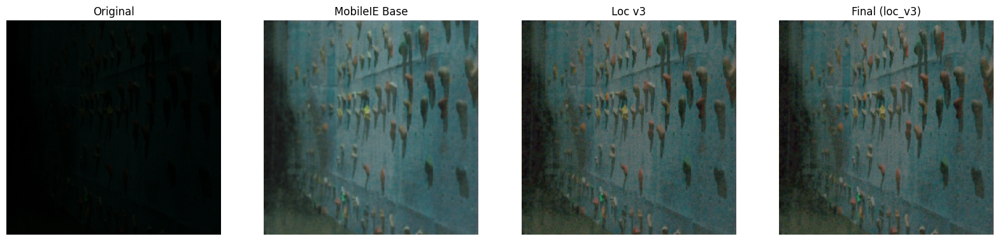


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00712.png
mean_o=0.124, contrast_o=0.062
bright_o=0.000, bright_b=0.017, bright_l=0.000
bright_spread=0.017
edge_o=0.044, edge_b=0.117, edge_l=0.105
edge_loss_base=-1.679, edge_loss_loc=-1.397
👉 AutoSelect v4 模式：loc_v3


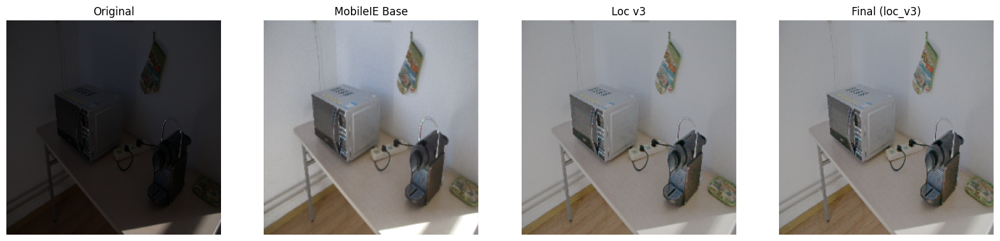


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00708.png
mean_o=0.045, contrast_o=0.043
bright_o=0.000, bright_b=0.013, bright_l=0.000
bright_spread=0.013
edge_o=0.035, edge_b=0.117, edge_l=0.129
edge_loss_base=-2.382, edge_loss_loc=-2.727
👉 AutoSelect v4 模式：loc_v3


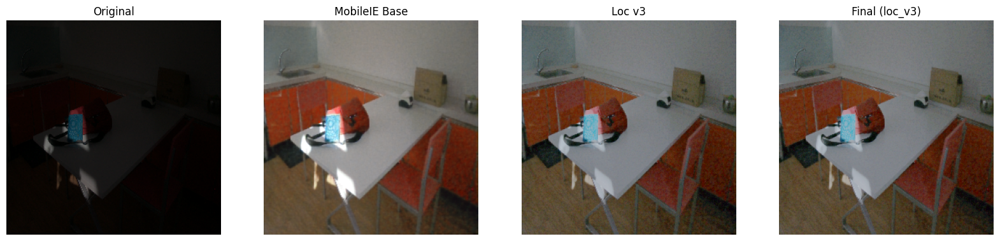


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00719.png
mean_o=0.130, contrast_o=0.119
bright_o=0.000, bright_b=0.098, bright_l=0.000
bright_spread=0.098
edge_o=0.109, edge_b=0.202, edge_l=0.215
edge_loss_base=-0.849, edge_loss_loc=-0.973
👉 AutoSelect v4 模式：loc_v3


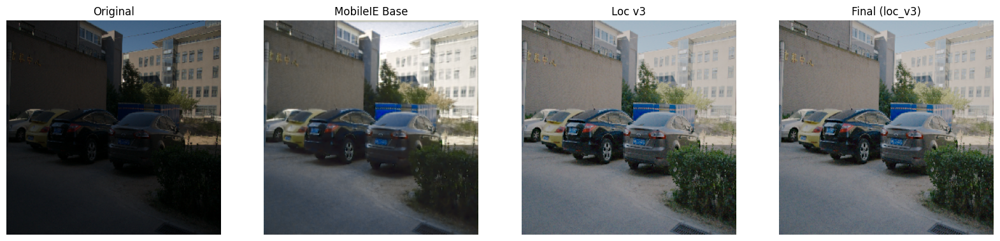


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00691.png
mean_o=0.057, contrast_o=0.048
bright_o=0.001, bright_b=0.004, bright_l=0.001
bright_spread=0.003
edge_o=0.055, edge_b=0.166, edge_l=0.178
edge_loss_base=-2.013, edge_loss_loc=-2.233
👉 AutoSelect v4 模式：loc_v3


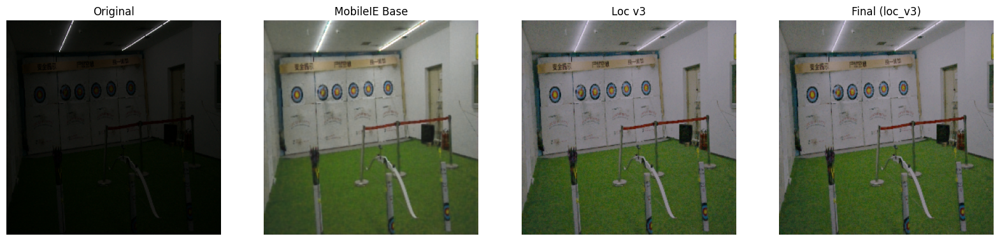


📌 圖片： /content/LOLv2/LOL-v2/Real_captured/Test/Low/low00733.png
mean_o=0.102, contrast_o=0.047
bright_o=0.000, bright_b=0.000, bright_l=0.000
bright_spread=0.000
edge_o=0.071, edge_b=0.194, edge_l=0.190
edge_loss_base=-1.755, edge_loss_loc=-1.696
👉 AutoSelect v4 模式：loc_v3


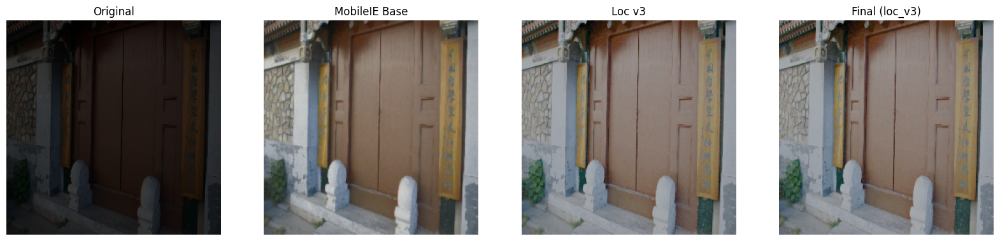

In [ ]:
lolv2_root = "/content/LOLv2/LOL-v2/Real_captured/Test/Low"
all_imgs = glob.glob(lolv2_root + "/*.png")
print("LOLv2 Test/Low 圖片數：", len(all_imgs))

for p in random.sample(all_imgs, 10):
    show_compare(p, resize_to=256)


✔ Using image: /content/contrast_dataset/ExDark/Bicycle/2015_00017.jpg
Using device: cuda
✔ MobileIE baseline loaded


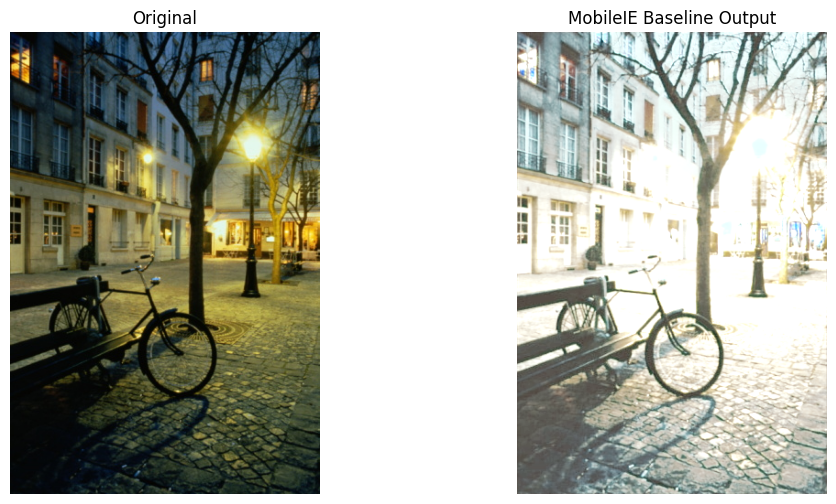

In [ ]:
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_tensor, to_pil_image

# ============================================
# 1. 指定圖片路徑
# ============================================
img_path = "/content/contrast_dataset/ExDark/Bicycle/2015_00017.jpg"
print("✔ Using image:", img_path)

img_bgr = cv2.imread(img_path)
if img_bgr is None:
    raise ValueError("❌ Cannot read image. Check your path!")

img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)


# ============================================
# 2. 載入 MobileIE Slim baseline 模型
# ============================================
import sys
sys.path.append("/content/MobileIE")

from model.lle import MobileIELLENetS

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", device)

model = MobileIELLENetS(channels=12)
state = torch.load("/content/MobileIE/pretrain/lolv2_real_best_slim.pkl",
                   map_location=device)
model.load_state_dict(state)
model = model.to(device).eval()

print("✔ MobileIE baseline loaded")


# ============================================
# 3. 推論
# ============================================
img_t = to_tensor(img_rgb).unsqueeze(0).to(device)

with torch.no_grad():
    out_t = model(img_t).clamp(0,1)[0].cpu()

out_img = np.array(to_pil_image(out_t))


# ============================================
# 4. 顯示結果 (Original vs MobileIE Output)
# ============================================
plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_rgb); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(out_img); plt.title("MobileIE Baseline Output"); plt.axis("off")
plt.show()


Using device: cuda
✔ MobileIE Slim Loaded
Final mode selected: loc_v3


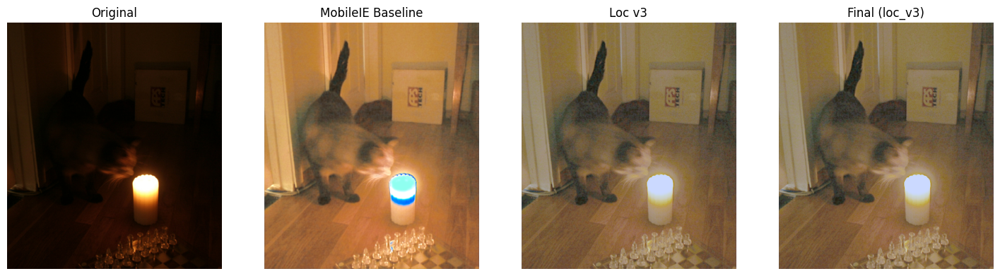

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✔ Download ready: enhanced_final.png


In [ ]:
# ============================================================
#   FULL Inference Pipeline: Baseline + Loc v3 + AutoSelect v4
# ============================================================

import cv2, torch, numpy as np, matplotlib.pyplot as plt
from torchvision.transforms.functional import to_tensor, to_pil_image
from google.colab import files
import sys
sys.path.append("/content/MobileIE")

# ------------------ Load MobileIE Slim ----------------------
from model.lle import MobileIELLENetS

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", device)

model = MobileIELLENetS(channels=12)
state = torch.load("/content/MobileIE/pretrain/lolv2_real_best_slim.pkl",
                   map_location=device)
model.load_state_dict(state)
model = model.to(device).eval()

print("✔ MobileIE Slim Loaded")


# ------------------ Helper: Baseline ------------------------
def run_baseline(img_rgb):
    t = to_tensor(img_rgb).unsqueeze(0).to(device)
    with torch.no_grad():
        out = model(t).clamp(0,1)[0].cpu()
    return np.array(to_pil_image(out))


# ------------------ Loc v3 (improved inference) -------------
def smoothstep(e0, e1, x):
    t = np.clip((x - e0) / (e1 - e0), 0, 1)
    return t * t * (3 - 2 * t)

def dark_mask(img_rgb, dark_thr=0.48, low=0.20, high=0.70):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY) / 255.0
    inv = np.clip((dark_thr - gray) / dark_thr, 0, 1)
    m = smoothstep(low, high, inv)
    return np.stack([m]*3, axis=-1)

def restore_local_contrast(img, amount=0.15, sigma=4.0):
    blur = cv2.GaussianBlur(img, (0,0), sigma)
    out = img.astype(float) + amount * (img.astype(float) - blur.astype(float))
    return np.clip(out, 0, 255).astype(np.uint8)

def protect_highlights(img, strength=0.15):
    img_f = img.astype(float) / 255.0
    out = img_f / (img_f + strength)
    return np.clip(out * 255.0, 0, 255).astype(np.uint8)

def gray_world_balance(img, mix=0.30):
    img = img.astype(float)
    mean_c = img.mean(axis=(0,1), keepdims=True)
    mean_all = img.mean()
    gain = mean_all / (mean_c + 1e-6)
    return np.clip(img * ((1-mix) + gain * mix), 0, 255).astype(np.uint8)

def run_loc_v3(original):
    base = run_baseline(original)
    mask = dark_mask(original)
    diff = base.astype(float) - original.astype(float)

    out = original.astype(float) + mask * diff * 0.16
    out = np.clip(out, 0, 255).astype(np.uint8)

    out = restore_local_contrast(out)
    out = protect_highlights(out)
    out = gray_world_balance(out)
    return out, base


# ---------------- AutoSelect v4 ------------------------------
def compute_gray(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0

def edge_strength(gray):
    gx = cv2.Sobel(gray, cv2.CV_32F, 1, 0)
    gy = cv2.Sobel(gray, cv2.CV_32F, 0, 1)
    return float(np.sqrt(gx*gx + gy*gy).mean())

def auto_select(original, base, loc):
    g_o, g_b, g_l = compute_gray(original), compute_gray(base), compute_gray(loc)

    contrast_o, contrast_l = g_o.std(), g_l.std()
    bright_spread = (g_b > .85).mean() - (g_o > .85).mean()
    edge_loss_base = (edge_strength(g_o) - edge_strength(g_b)) / max(edge_strength(g_o), 1e-6)

    # Fail detection
    color_shift = np.mean(np.abs(base.astype(float) - original.astype(float)) / 255.0)
    neg_score = np.mean(base.mean(axis=2) < original.mean(axis=2))

    if color_shift > 0.22 or neg_score > 0.60:
        return loc, "loc_v3"

    if bright_spread > 0.10:
        return loc, "loc_v3"

    if edge_loss_base > 0.25:
        return loc, "loc_v3"

    if contrast_l < 0.6 * contrast_o:
        return base, "baseline"

    return base, "baseline"


# ============================================================
#  RUN: Use a fixed path
# ============================================================

img_path = "/content/contrast_dataset/ExDark/Cat/2015_03480.jpg"
# img_path = "/content/contrast_dataset/ExDark/Cat/2015_03491.jpg"
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

loc3, base = run_loc_v3(img_rgb)
final, mode = auto_select(img_rgb, base, loc3)

print("Final mode selected:", mode)


# ============================================================
#  SHOW (4 images)
# ============================================================

plt.figure(figsize=(18,6))
plt.subplot(1,4,1); plt.imshow(img_rgb); plt.title("Original"); plt.axis("off")
plt.subplot(1,4,2); plt.imshow(base); plt.title("MobileIE Baseline"); plt.axis("off")
plt.subplot(1,4,3); plt.imshow(loc3); plt.title("Loc v3"); plt.axis("off")
plt.subplot(1,4,4); plt.imshow(final); plt.title(f"Final ({mode})"); plt.axis("off")
plt.show()


# ============================================================
#  SAVE + DOWNLOAD final output
# ============================================================

save_name = "enhanced_final.png"
cv2.imwrite(save_name, cv2.cvtColor(final, cv2.COLOR_RGB2BGR))
files.download(save_name)
print("✔ Download ready:", save_name)
